<a href="https://colab.research.google.com/github/dpdusi/Face_Detection/blob/main/Face_Recognition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Ultralytics YOLOv8.0.20 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU
Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs


Face embedding: [0.5791909694671631, -0.30144327878952026, 0.5358800292015076, -1.960081696510315, -1.648259162902832, 2.5435240268707275, 0.19059158861637115, -1.0023653507232666, -0.9933966398239136, 1.1418622732162476, -0.6442808508872986, 0.31665652990341187, 0.4084763526916504, 1.824851155281067, 0.7315844297409058, -0.3117353916168213, 1.1124407052993774, -1.4821486473083496, 0.6871123313903809, -1.6846340894699097, 0.47312501072883606, -1.5821233987808228, 0.3439142107963562, -1.3144432306289673, 1.3694356679916382, -1.8665751218795776, 0.20294807851314545, 0.7572005391120911, -0.5893320441246033, 0.891912043094635, 0.4379931688308716, -1.3263019323349, 0.7966269254684448, -0.4971504807472229, 0.5745674967765808, 0.2395707368850708, -1.6624592542648315, 1.3478375673294067, 0.8575089573860168, 0.09771108627319336, 0.30188578367233276, -0.6603856682777405, 1.1729377508163452, -0.0707724466919899, 0.5711157321929932, -0.1255955845117569, -1.9509000778198242, 0.4388461112976074, -0.

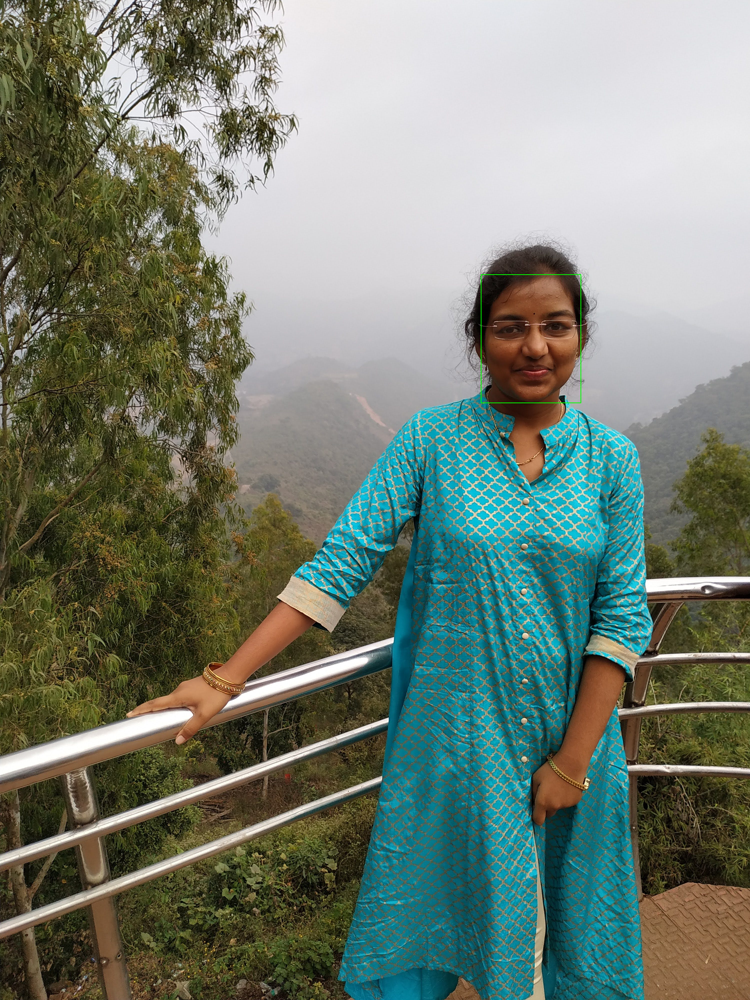

In [7]:
!pip install ultralytics==8.0.20
!pip install deepface

import cv2
import numpy as np
from ultralytics import YOLO
from deepface import DeepFace
from google.colab.patches import cv2_imshow


# Load the YOLO model
model = YOLO("YoloV8best.pt")  # Replace with the path to your trained YOLO model

# Function to generate embeddings from the cropped face using DeepFace
def get_face_embedding(face_image):
    embedding = DeepFace.represent(face_image, model_name='Facenet', enforce_detection=False)[0]['embedding']
    return embedding


# Read the input image
image_path = '/content/Monica.jpg'
image = cv2.imread(image_path)

# Predict faces using the trained YOLO model
results = model.predict(image_path)

# Loop through each detected face in the results
for result in results[0].boxes.data:  # result[0] contains the detection result
    x1, y1, x2, y2 = result[:4]  # Bounding box coordinates (x1, y1, x2, y2)

    # Crop the face from the image using the bounding box
    face_image = image[int(y1):int(y2), int(x1):int(x2)]

    # Optionally, resize the face image if needed for the model
    face_image = cv2.resize(face_image, (160, 160))  # Example for FaceNet or similar models

    # Get the embedding for the cropped face
    embedding = get_face_embedding(face_image)

    # Optionally, print or save the embeddings
    print(f"Face embedding: {embedding}")

    # Draw bounding box on the original image
    cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)

# Display the image with bounding boxes
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()
